In [ ]:
!git clone https://github.com/sskyisthelimit/DS_Internship.git

In [ ]:
cd DS_Internship/CV/

In [ ]:
!pip install -r requirements.txt

In [ ]:
cd ../../

In [ ]:
!git clone --quiet https://github.com/sskyisthelimit/LightGlueTune.git
%cd LightGlueTune
!pip install --progress-bar off --quiet -e .

In [6]:
filepath1 = "/kaggle/input/satellite-test-set/S2A_MSIL2A_20191206T085341_N0213_R107_T36UXA_20191206T102420/T36UXA_20191206T085341_TCI_10m.jp2"
filepath2 = "/kaggle/input/satellite-test-set/S2B_MSIL2A_20200320T084639_N0214_R107_T36UXA_20200320T112112/T36UXA_20200320T084639_TCI_10m.jp2"

after tuning both extractor and matcher (i got results with no matches produced (in the end of notebook), so in cells below i testing with original weights to be sure that problem is not in LightGlueTune repo **but in something else (issue #83 cvg/LightGlue, explained in below markdown cells)**

In [ ]:
from lightglue import LightGlue, SuperPoint
device = "cuda:0"
orig_sp_ckpt_path = "../DS_Internship/CV/assets/superpoint_official.pth"
orig_lg_ckpt_path = "../DS_Internship/CV/assets/lightglue_official.pth"

orig_extractor = SuperPoint(max_num_keypoints=1500,
                             ckpt_path=orig_sp_ckpt_path).eval().to(device)

orig_matcher = LightGlue(features="superpoint",
                          custom=False,
                          ckpt_path=orig_lg_ckpt_path).eval().to(device)

In [ ]:
cd ../DS_Internship/CV/src

In [10]:
from inference_utils import (
    visualize_kpts, load_npy,
    lightglue_matcher, visualize_matches
)
matches_filenames = ["img1_matches.npy", "img2_matches.npy"]
kpts_filenames = ["img_1_kpts.npy", "img_2_kpts.npy"]

lightglue_matcher(
      path_img_1=filepath1,
      path_img_2=filepath2,
      matcher=orig_matcher,
      extractor=orig_extractor,
      w=10980,
      h=10980,
      n_pair=20,
      crp_w=1098,
      crp_h=1098,
      device=device,
      save_dir="/kaggle/working",
      limit_printing=None,
      matches_filenames=matches_filenames,
      kpts_filenames=kpts_filenames,
      padding=12)

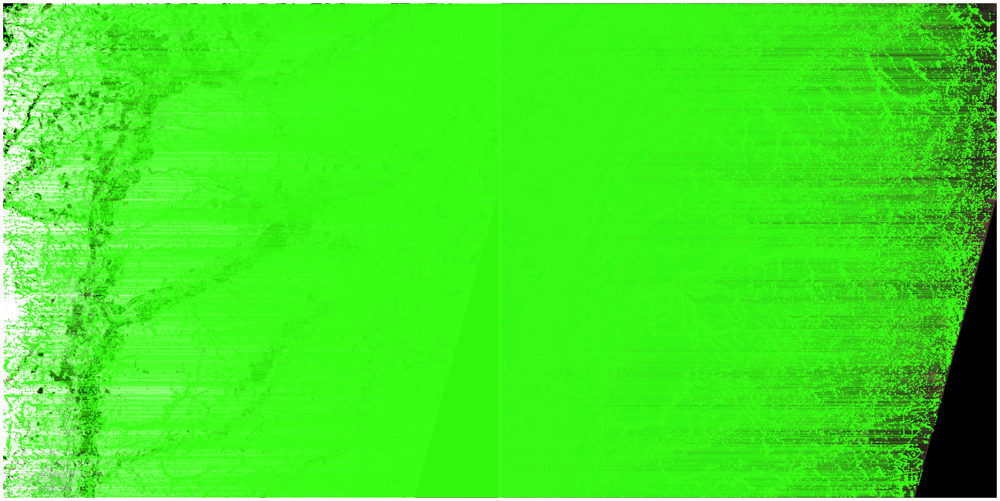

In [11]:
import cv2
plotting_size = 2000

img1 = cv2.cvtColor(cv2.imread(filepath1), cv2.COLOR_BGR2RGB)
img2 = cv2.cvtColor(cv2.imread(filepath2), cv2.COLOR_BGR2RGB)

resized_img1 = cv2.resize(img1, (plotting_size, plotting_size), interpolation=cv2.INTER_AREA)
resized_img2 = cv2.resize(img2, (plotting_size, plotting_size), interpolation=cv2.INTER_AREA)

img_1_matches, img_2_matches = load_npy(
    filenames=matches_filenames,
    save_dir="/kaggle/working"
) 

img_1_matches *= [plotting_size / img1.shape[1], plotting_size / img1.shape[0]]
img_2_matches *= [plotting_size / img2.shape[1], plotting_size / img2.shape[0]]

visualize_matches(resized_img1, resized_img2, img_1_matches, img_2_matches)

i use padding parameter to add intersections beetween crops, because when padding is 0 we get 'white' (not lime color as if for this case) lines on image without matches, i think the problem is in - how matcher behaves on borders of image

In [12]:
print(img_1_matches.shape)
print(img_2_matches.shape)

(63834, 2)
(63834, 2)


/kaggle/working/DS_Internship/CV/src/inference_utils.py:362: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(kpts[:, 0], kpts[:, 1],


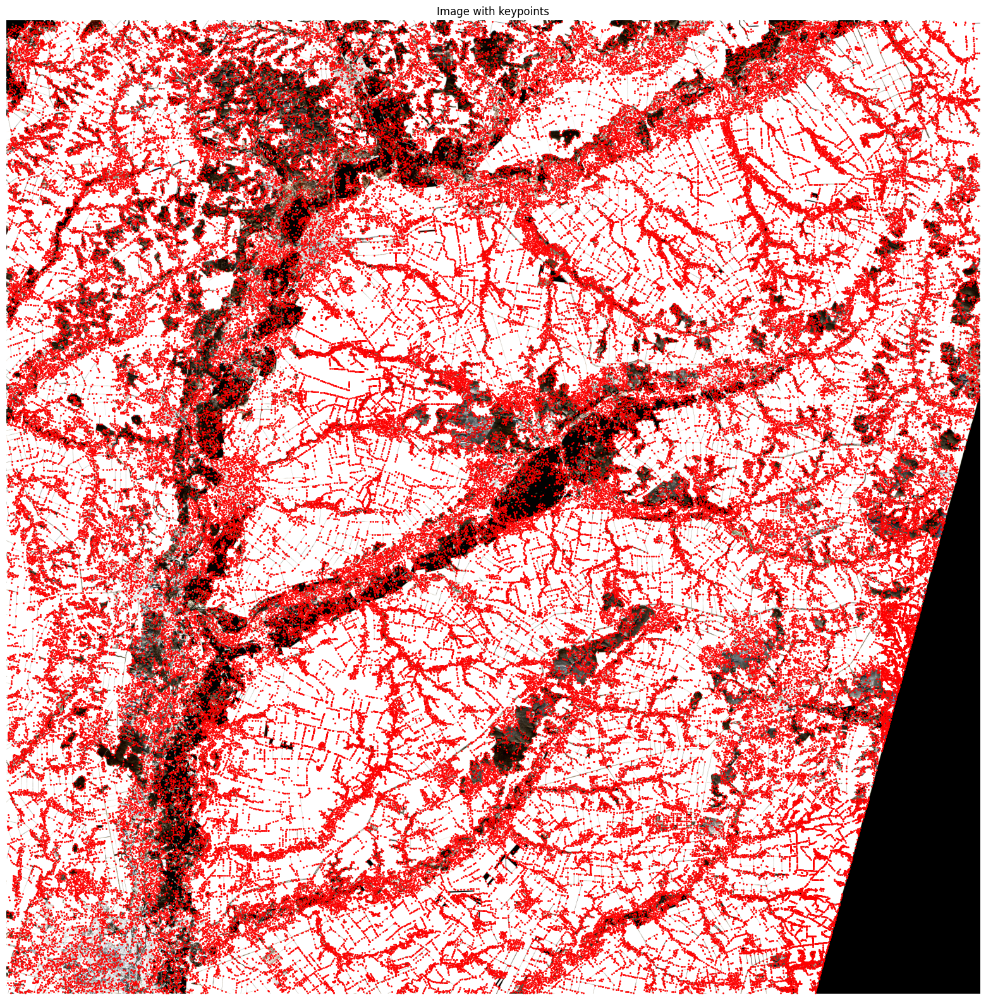

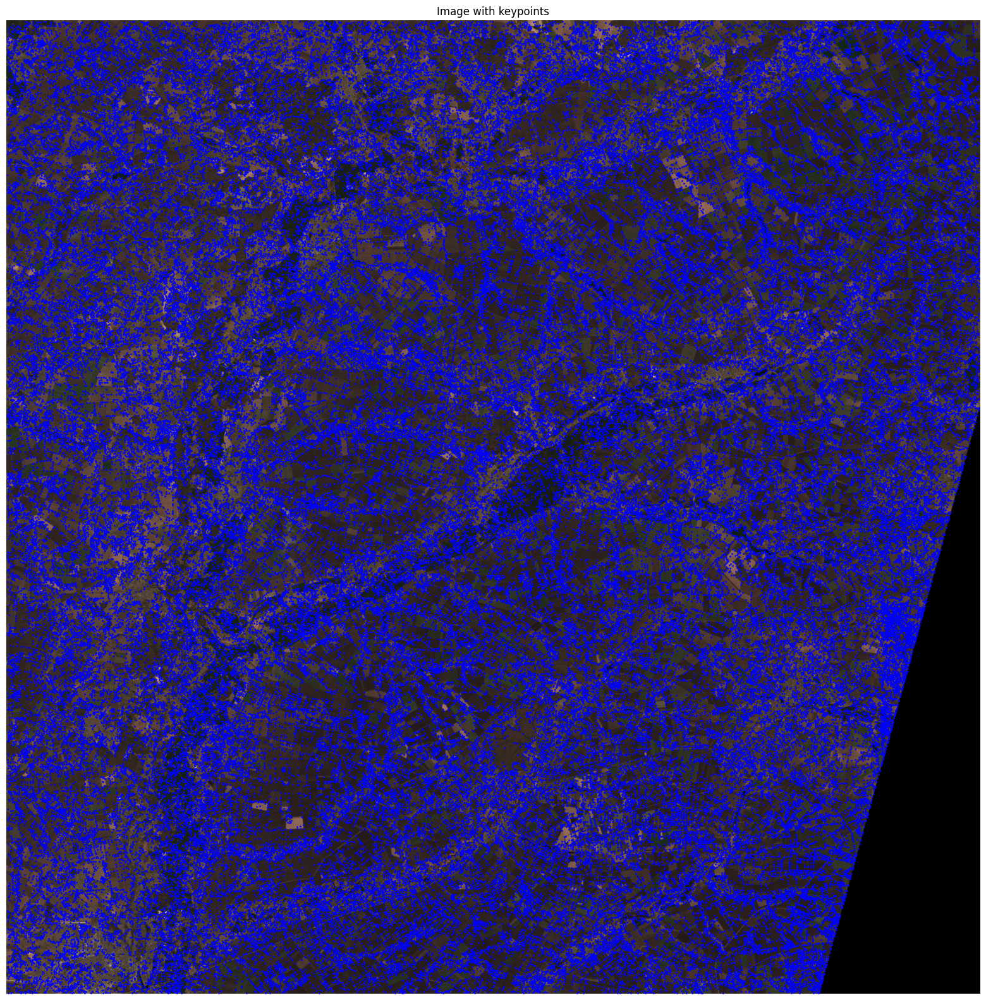

In [13]:
kpts1, kpts2 = load_npy(filenames=kpts_filenames,
                       save_dir="/kaggle/working/")

img1_kpts = cv2.cvtColor(cv2.imread(filepath1), cv2.COLOR_BGR2RGB)
img2_kpts = cv2.cvtColor(cv2.imread(filepath2), cv2.COLOR_BGR2RGB)

scale_x = plotting_size / img1_kpts.shape[1]
scale_y = plotting_size / img1_kpts.shape[0]

kpts1 = kpts1 * [scale_x, scale_y]
kpts2 = kpts2 * [scale_x, scale_y]

resized_kpts_img1 = cv2.resize(img1_kpts, (plotting_size, plotting_size), interpolation=cv2.INTER_AREA)
resized_kpts_img2 = cv2.resize(img2_kpts, (plotting_size, plotting_size), interpolation=cv2.INTER_AREA)

visualize_kpts(resized_kpts_img1,
              kpts1)

visualize_kpts(resized_kpts_img2,
              kpts2,
              color=(0, 0, 255))

In [14]:
print(kpts1.shape)
print(kpts2.shape)

(145621, 2)
(145815, 2)


as you can seen everything seems to be okay above, so the issue shouldn't be with some modification i did in initial cvg/LightGlue repo.

tuned superpoint checkpoint (by completing tuning steps 2 and 3 from QuantuMobileSoftware/pytorch-superpoint repo which is fork of eric-yyjau/pytorch-superpoint)
**(code in my DS_Internship/CV/notebooks/superpoint/)**

tuned lightglue checkpoint (by completing tuning step 1 (pre-training LightGlue on the homography dataset by using my fork of cvg/glue-factory)
**(code in my DS_Internship/CV/notebooks/lightglue/)**

In [15]:
tuned_sp_ckpt_path = "/kaggle/input/tuned-matching-checkpoints/tuned_checkpoints/superpoint.tar"
tuned_lg_ckpt_path = "/kaggle/input/tuned-matching-checkpoints/tuned_checkpoints/lightglue.tar"

tuned_extractor = SuperPoint(max_num_keypoints=1500,
                             ckpt_path=tuned_sp_ckpt_path).eval().to(device)

tuned_matcher = LightGlue(features="superpoint",
                          custom=True,
                          ckpt_path=tuned_lg_ckpt_path).eval().to(device)

loaded model from path /kaggle/input/tuned-matching-checkpoints/tuned_checkpoints/superpoint.tar


/kaggle/working/LightGlueTune/lightglue/lightglue.py:411: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  ckpt = torch.load(str(ckpt), map_location="cpu")


Loading checkpoint....
Loading state dict....


In [16]:
matches_filenames = ["img1_matches.npy", "img2_matches.npy"]
kpts_filenames = ["img_1_kpts.npy", "img_2_kpts.npy"]

lightglue_matcher(
      path_img_1=filepath1,
      path_img_2=filepath2,
      matcher=tuned_matcher,
      extractor=tuned_extractor,
      w=10980,
      h=10980,
      n_pair=20,
      crp_w=1098,
      crp_h=1098,
      device=device,
      save_dir="/kaggle/working",
      limit_printing=None,
      matches_filenames=matches_filenames,
      kpts_filenames=kpts_filenames)

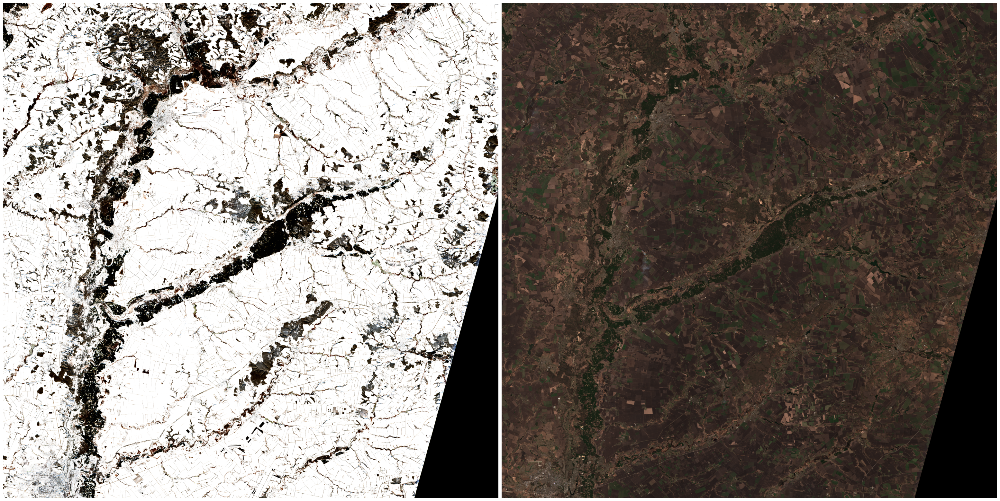

In [17]:
plotting_size = 2000

img1 = cv2.cvtColor(cv2.imread(filepath1), cv2.COLOR_BGR2RGB)
img2 = cv2.cvtColor(cv2.imread(filepath2), cv2.COLOR_BGR2RGB)

resized_img1 = cv2.resize(img1, (plotting_size, plotting_size), interpolation=cv2.INTER_AREA)
resized_img2 = cv2.resize(img2, (plotting_size, plotting_size), interpolation=cv2.INTER_AREA)

img_1_matches, img_2_matches = load_npy(
    filenames=matches_filenames,
    save_dir="/kaggle/working"
) 

img_1_matches *= [plotting_size / img1.shape[1], plotting_size / img1.shape[0]]
img_2_matches *= [plotting_size / img2.shape[1], plotting_size / img2.shape[0]]

visualize_matches(resized_img1, resized_img2, img_1_matches, img_2_matches)

In [18]:
print(img_1_matches.shape)
print(img_2_matches.shape)

(0, 2)
(0, 2)


you can just type **issue #83 LightGlue** to get all insights about why i got no matches above, however considering that i tuned lightglue using my tuned superpoint weights i currently don't understand what stops it from learning representation of descriptors, but i also tried to change mysterious parameter 'trainable' for extractor in 'gluefactory/configs/superpoint+lightglue_homography.yaml' file that should allow not only adjust LightGlue weights but also SuperPoint BUT i get out of memory error even when batch size is 16 (on P100, 2X T4) (I know that with 3090 24gb it should work but i don't have one currently)

conclusion:
i'm not stuck with this issue, just time needed to solve, other idea i got is - try to look on SuperGlue (maybe everything easier there) even considering that it's much slower

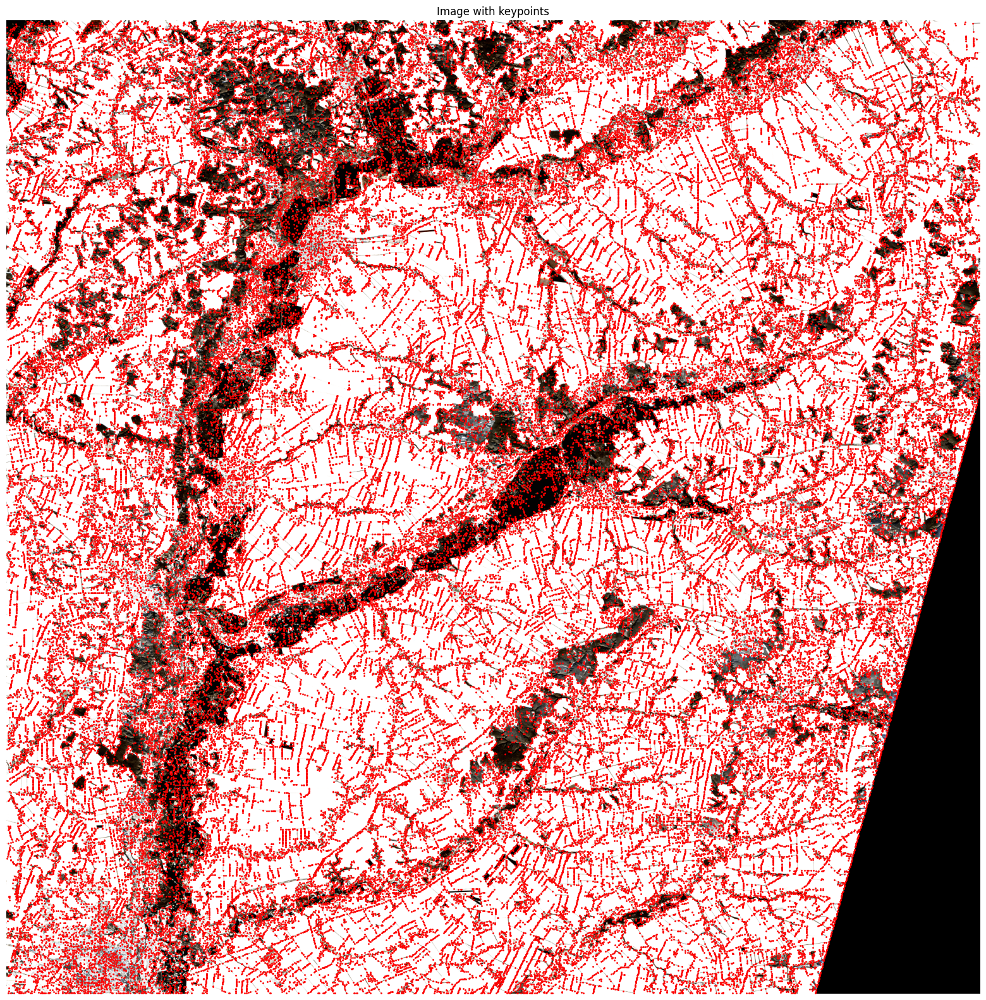

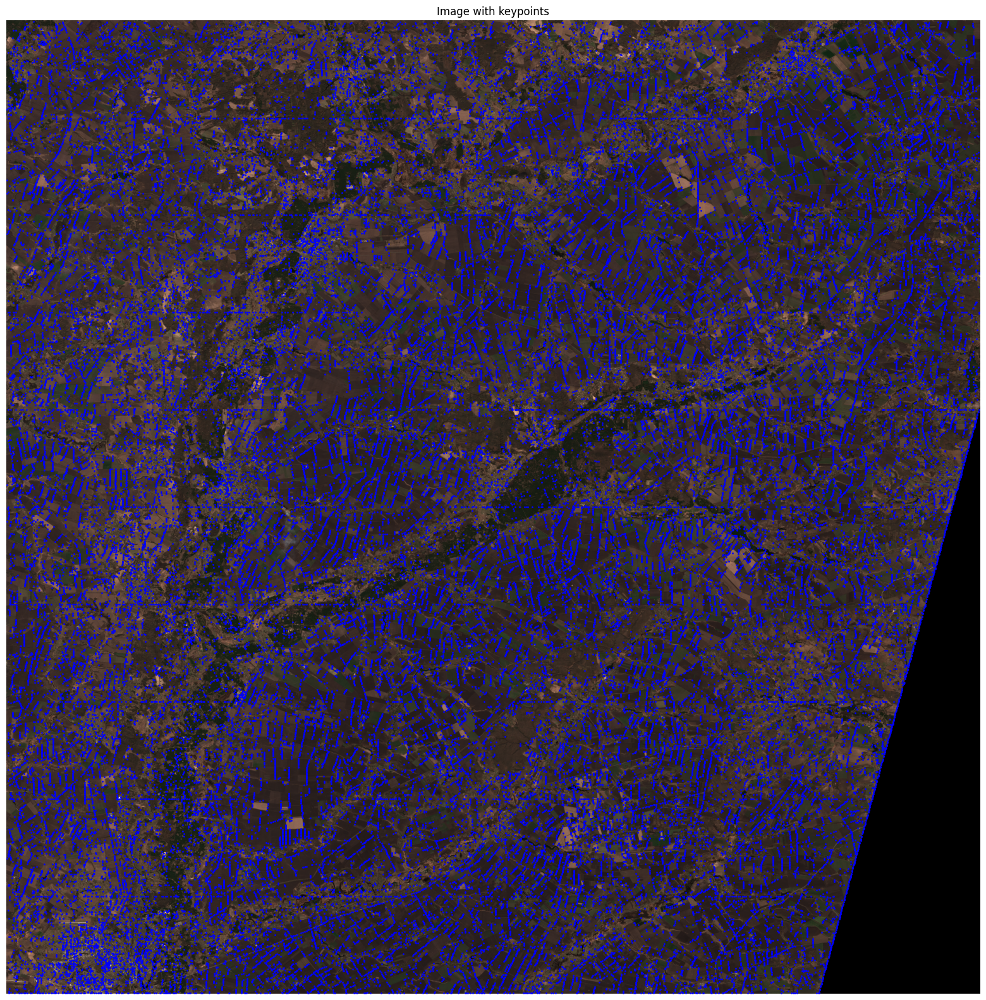

In [19]:
kpts1, kpts2 = load_npy(filenames=kpts_filenames,
                       save_dir="/kaggle/working/")

img1_kpts = cv2.cvtColor(cv2.imread(filepath1), cv2.COLOR_BGR2RGB)
img2_kpts = cv2.cvtColor(cv2.imread(filepath2), cv2.COLOR_BGR2RGB)

scale_x = plotting_size / img1_kpts.shape[1]
scale_y = plotting_size / img1_kpts.shape[0]

kpts1 = kpts1 * [scale_x, scale_y]
kpts2 = kpts2 * [scale_x, scale_y]

resized_kpts_img1 = cv2.resize(img1_kpts, (plotting_size, plotting_size), interpolation=cv2.INTER_AREA)
resized_kpts_img2 = cv2.resize(img2_kpts, (plotting_size, plotting_size), interpolation=cv2.INTER_AREA)

visualize_kpts(resized_kpts_img1,
              kpts1)

visualize_kpts(resized_kpts_img2,
              kpts2,
              color=(0, 0, 255))

In [20]:
print(kpts1.shape)
print(kpts2.shape)

(122803, 2)
(66203, 2)


as you can see - even after transfer learning tuning SuperPoint is far worse that initial
i think there might be couple reasons:
1? i used resolution 640x480 while tuning instead 320x240
2? larger dataset needed
3? transfer learning is a bad idea? (i already tried doing without adjusting pretrained (training from scratch), it showed worse results (i judged in terms of how much keypoints are found), i can't currently load it to repo because there's some bugs with kaggle datasets)
